In [1]:
import matplotlib
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt  # Standard plotting

import networkx as nx # reconstruct network
import random  # For Python’s own RNG (not used yet)

import cv2
from StructuralGT.electronic import Electronic
from StructuralGT.networks import Network

%config InlineBackend.figure_format = 'retina'  # Jupyter setting for high-res inline plots (won’t work in script mode)

In [2]:
# particle dynamics 

class Particle:
    def __init__(self, x, y, p_run, p_tumble, theta, speed, p_link, L_link_mean, L_link_std):
        self.position = np.array([x, y])  # Current position (in unit square)
        self.p_run = p_run  # Probability of running at each timestep
        self.p_tumble = p_tumble  # Probability of tumbling (direction change)
        self.theta = theta  # Current heading (angle in radians)
        self.speed = speed  # Speed per timestep
        self.p_link = p_link  # Probability of laying a link at each timestep
        self.L_link_mean = L_link_mean  # Mean link length
        self.L_link_std = L_link_std  # Std dev of link length

    def maybe_lay_link(self):
        if np.random.rand() < self.p_link:
            # Sample link length from Gaussian, fold negative to positive
            L_link = np.abs(np.random.normal(self.L_link_mean, self.L_link_std))
            return True, L_link
        return False, 0.0

    def run(self, dt):
        if np.random.rand() < self.p_run:
            displacement = self.speed * dt # how far does the particle run?
            dx = displacement * np.cos(self.theta) # change in x coordinate (w/ orientation)
            dy = displacement * np.sin(self.theta) # change in y coordinate (w/ orientation)
            self.position = (self.position + np.array([dx, dy])) % 1.0  # Enforce periodic boundaries

    def tumble(self):
        if np.random.rand() < self.p_tumble:
            self.theta = np.random.uniform(-np.pi, np.pi)  # Randomly sample new direction

edges = []  # List of edges as ((x1, y1), (x2, y2)) tuples
nodes = []  # List of node positions

def add_link(particle, L_link):
    # 1) Compute raw endpoints (may lie outside [0,1]) and center
    dx      = 0.5 * L_link * np.cos(particle.theta)
    dy      = 0.5 * L_link * np.sin(particle.theta)
    centre  = (particle.position % 1.0)            # wrapped center in [0,1]
    
    # Record the node at the deposition site
    nodes.append(centre.copy())

    raw_start = particle.position - np.array([dx, dy])
    raw_end   = particle.position + np.array([dx, dy])
    delta     = raw_end - raw_start

    # helper to wrap a point into [0,1)
    wrap = lambda v: tuple((v % 1.0).tolist())

    # 2) Detect whether we cross a periodic boundary
    wrap_x = abs(delta[0]) > 0.5
    wrap_y = abs(delta[1]) > 0.5
    pieces = []

    if wrap_x:
        # split at the vertical wall x=0 or x=1
        boundary = 1.0 if delta[0] > 0 else 0.0
        t = (boundary - raw_start[0]) / delta[0]
        mid = raw_start + t * delta
        pieces.append((wrap(raw_start), wrap(mid)))
        pieces.append((wrap(mid),       wrap(raw_end)))
    elif wrap_y:
        # split at the horizontal wall y=0 or y=1
        boundary = 1.0 if delta[1] > 0 else 0.0
        t = (boundary - raw_start[1]) / delta[1]
        mid = raw_start + t * delta
        pieces.append((wrap(raw_start), wrap(mid)))
        pieces.append((wrap(mid),       wrap(raw_end)))
    else:
        # no wrap → a single segment
        pieces.append((wrap(raw_start), wrap(raw_end)))

    # 3) Append all resulting edge pieces
    for seg in pieces:
        edges.append(seg)

def simulate(N, steps, dt, particle_params):
    global nodes, edges
    nodes, edges = [], []  # Clear previous run data

    # Create N particles with randomized initial positions and angles
    particles = [
        Particle(
            x=np.random.rand(), y=np.random.rand(),  # Random position
            theta=np.random.uniform(-np.pi, np.pi),  # Random direction
            **particle_params  # Fill in other parameters
        )
        for _ in range(N)
    ]

    for step in range(steps):
        for p in particles:
            laid_link, L_link = p.maybe_lay_link()
            if laid_link:
                add_link(p, L_link)  # Add link if randomly chosen
            p.run(dt)  # Move forward (maybe)
            p.tumble()  # Change direction (maybe)

    # Placeholder for optional post-processing (like merging links)
    #edges[:] = merge_collinear_links(edges)

def plot_network(nodes, edges, step=None, fname='dynamics_1.tif', dpi=300):
    
    fig = plt.figure(figsize=(6, 6), frameon=False, dpi=dpi)
    ax = fig.add_axes([0, 0, 1, 1])

    for start, end in edges:
        if np.linalg.norm(np.array(start) - np.array(end)) > 0.5:
            continue
        ax.plot([start[0], end[0]], [start[1], end[1]], 'b-', linewidth=0.5)
    
    # Exact domain limits and aspect
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.set_aspect('equal', adjustable='box')

    # Remove every visual element
    ax.axis('off')
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.tick_params(left=False, bottom=False, labelleft=False, labelbottom=False)

    fig.savefig(fname, dpi=dpi, bbox_inches=None, pad_inches=0, transparent=True)
    plt.show()

## Network 1

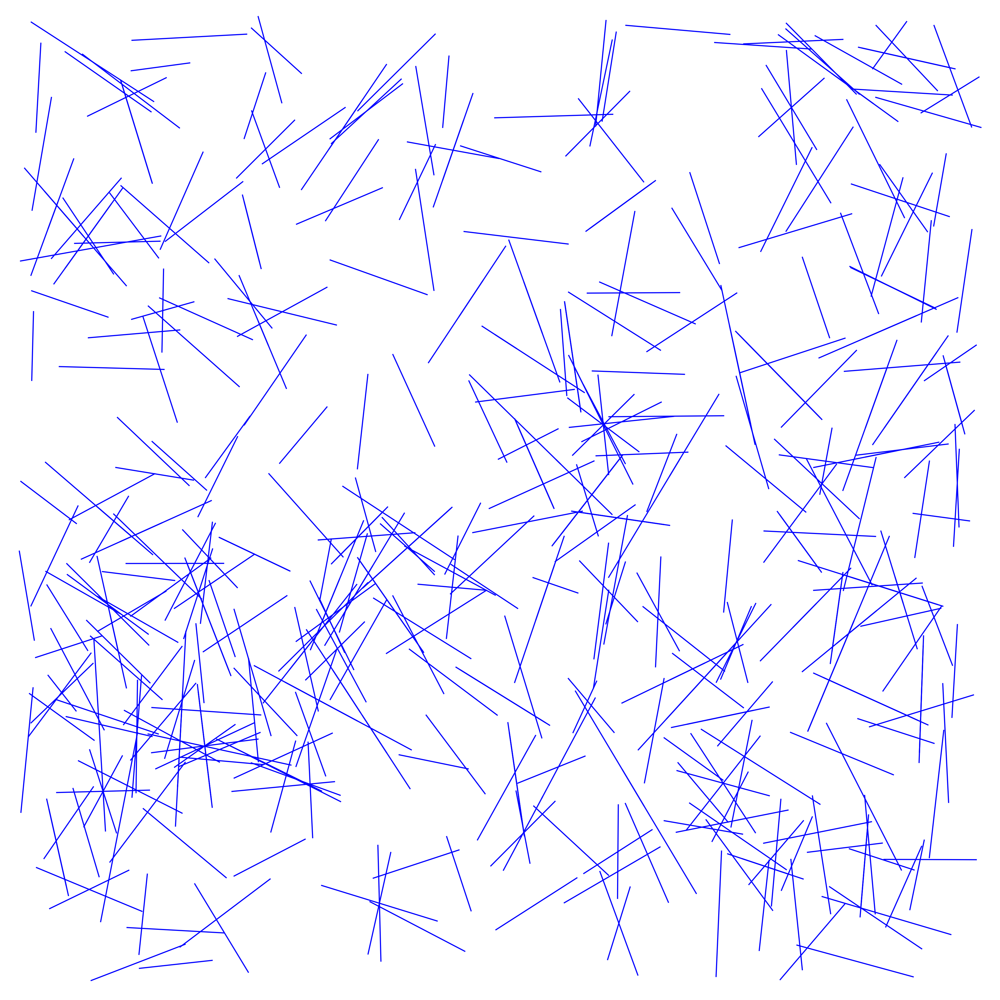

In [3]:
# 1. Define particle behavior parameters
params = {
    'p_run': 0.5,           # 50% chance of running
    'p_tumble': 0.5,        # 50% chance of tumbling
    'speed': 0.05,          # Distance per time step
    'p_link': 0.2,          # 20% chance of laying a link per step
    'L_link_mean': 0.1,     # Average link length (1/10 of box side length)
    'L_link_std': 0.02      # Std deviation of link length
}

# 2. Run the simulation
steps = 25
N = 100
dt = 1.0

simulate(N=N, steps=steps, dt=dt, particle_params=params)

# 3. Generate image of the network
plot_network(nodes, edges, step=steps)

In [5]:
from StructuralGT.networks import Network

Dynamics = Network('Dynamics')

Baseline binarization parameters:

Threshhold $\in$ [0,1] (0 is sharpest)

Gamma $\in$ [0,1] (1 is sharpest)

In [7]:
from StructuralGT import Binarizer

B = Binarizer('Dynamics/dynamics_1.tif')

interactive(children=(Dropdown(description='Threshold', layout=Layout(display='flex', flex_flow='row', justify…

In [8]:
Dynamics.binarize()

Ran img_to_skel() in  0.2151181697845459 for skeleton with  63014 voxels


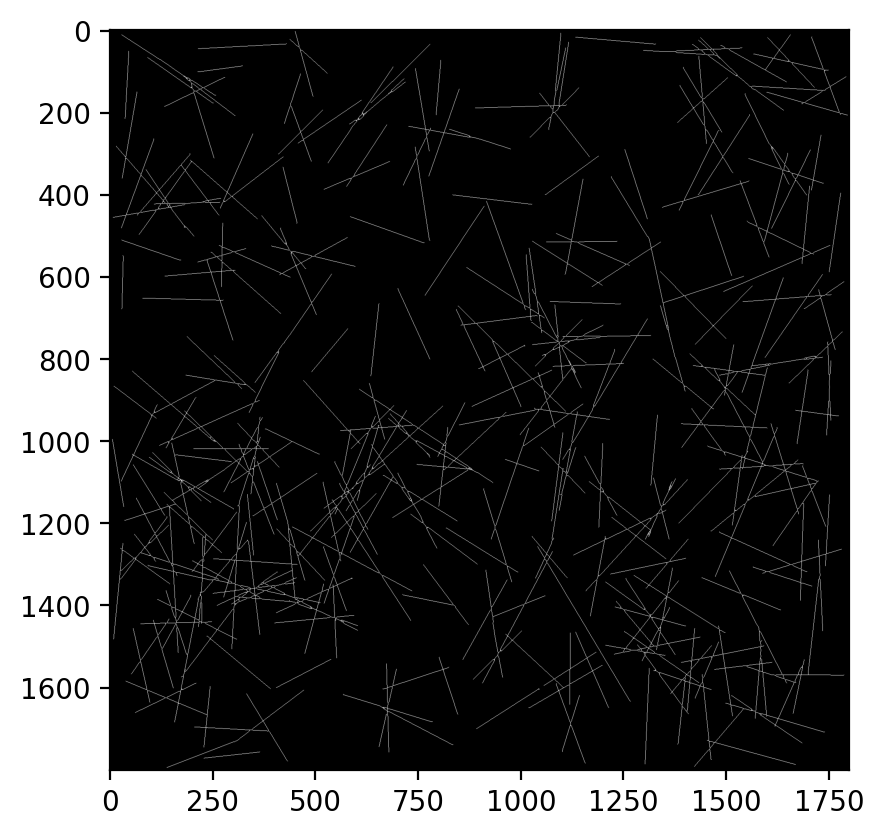

In [9]:
Dynamics.img_to_skel()
plt.imshow(Dynamics.skeleton, cmap='gray')

In [10]:
Dynamics.set_graph(sub=False)

implicit data copy when writing chunk: log/Edge_lens
implicit data copy when writing chunk: log/Node_lens


In [11]:
A = Dynamics.graph.get_adjacency()
print(A.shape)

(1789, 1789)


<Axes: >

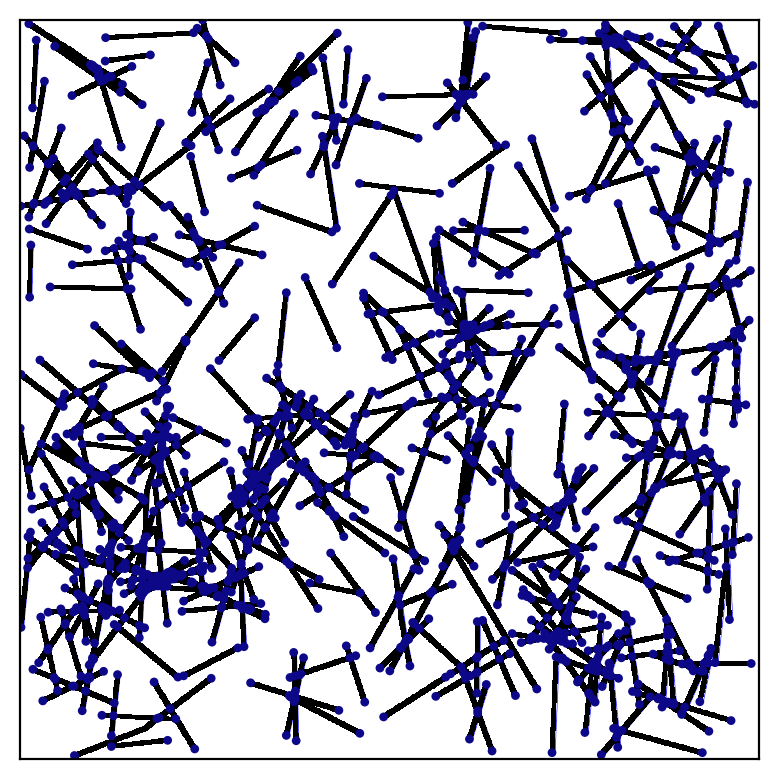

In [12]:
Dynamics.graph_plot()

## Network properties

**Diameter**: maximum number of edges to reach one node from any other node

**Density**: the fraction of edges that exist compared to all possible edges in a complete graph, given by $2e / n(n-1)$.

**Clustering coefficient**: the fraction of neighbors of a node that are directly connected to each other as well (forming a triangle), given by $2T_i / k_i (k_i-1)$, where $T_i$ is the number of connected triples on node $i$. 

In [13]:
from StructuralGT.structural import Size

S = Size()
S.compute(Dynamics)
print(f'Number of nodes is {S.number_of_nodes}')
print(f'Number of edges is {S.number_of_edges}')
print(f'Diameter is {S.diameter}')
print(f'Density (fraction of edges that exist compared to all possible edges in a complete graph) is {S.density}')

Number of nodes is 1789
Number of edges is 2171
Diameter is 87
Density (fraction of edges that exist compared to all possible edges in a complete graph) is 0.0013574128748516602


Average degree is 2.4270542202347682


(array([626.,  51.,   0., 866.,   0., 225.,  12.,   0.,   7.,   2.]),
 array([1. , 1.6, 2.2, 2.8, 3.4, 4. , 4.6, 5.2, 5.8, 6.4, 7. ]),
 <BarContainer object of 10 artists>)

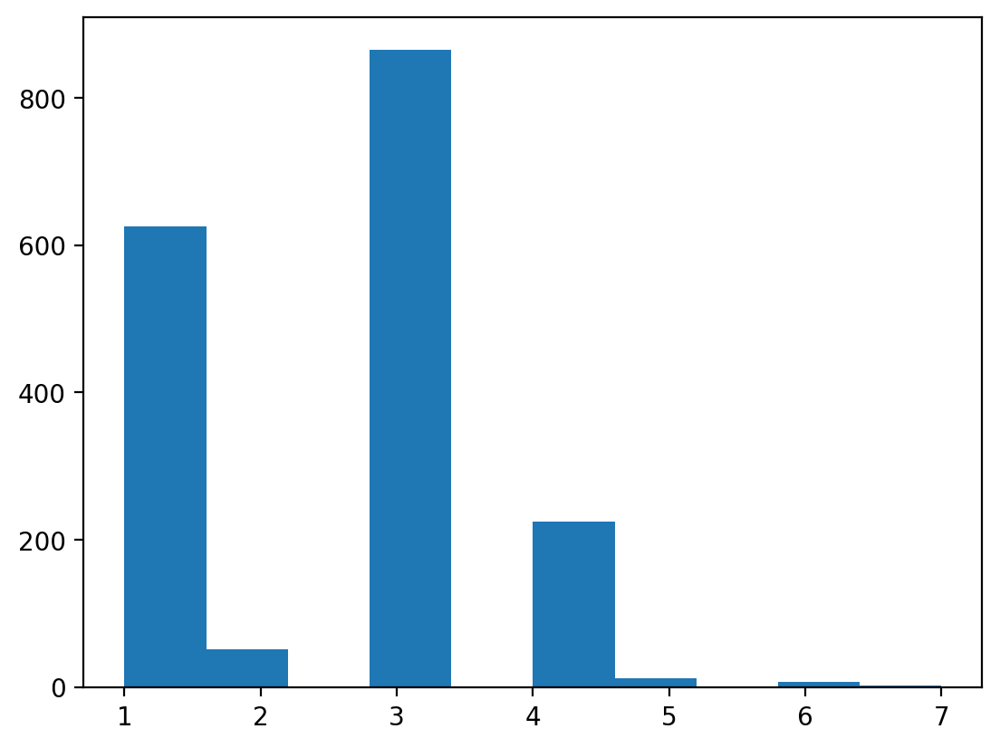

In [14]:
from StructuralGT.structural import Degree

D = Degree()
D.compute(Dynamics)
print(f'Average degree is {D.average_degree}')
plt.hist(D.degree)

<Axes: >

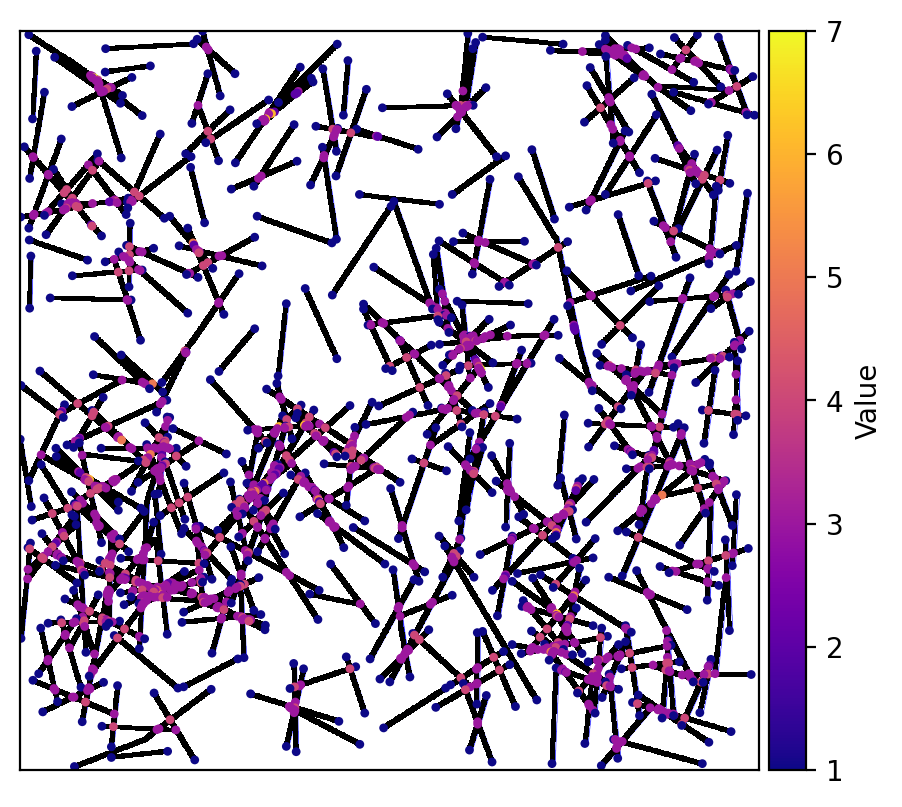

In [15]:
Dynamics.node_plot(parameter=D.degree)

Average clustering coefficient is 0.07497937129015943


(array([1.355e+03, 9.100e+01, 2.000e+00, 3.260e+02, 0.000e+00, 2.000e+00,
        1.200e+01, 0.000e+00, 0.000e+00, 1.000e+00]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

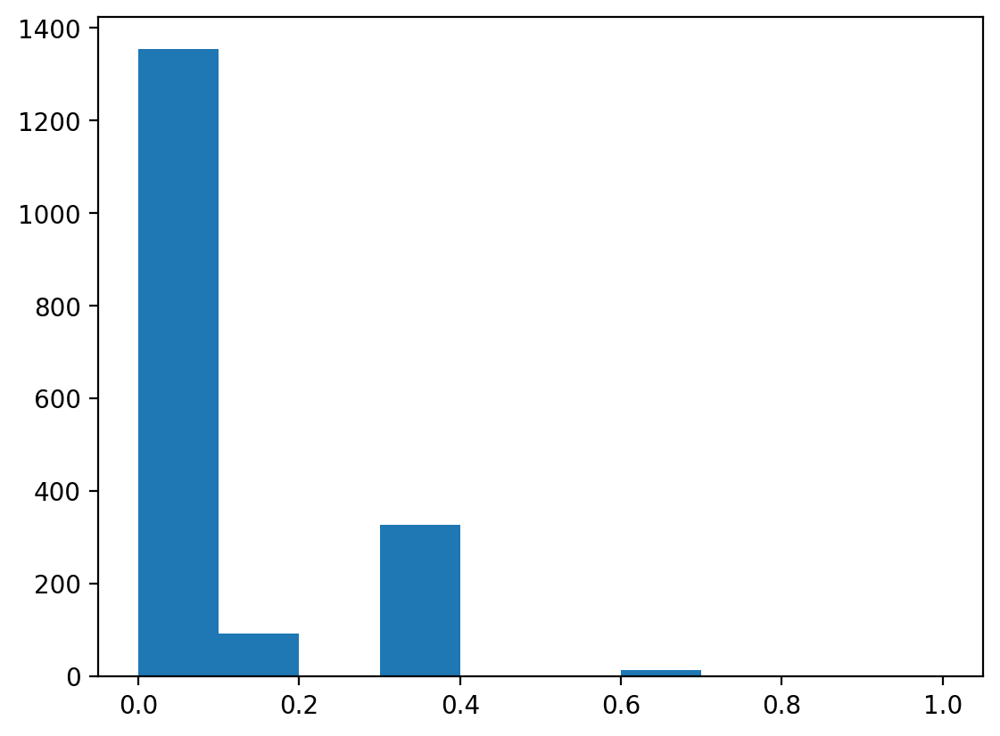

In [16]:
from StructuralGT.structural import Clustering

C = Clustering()
C.compute(Dynamics)

print(f'Average clustering coefficient is {C.average_clustering_coefficient}')

plt.hist(C.clustering)

## Network 2

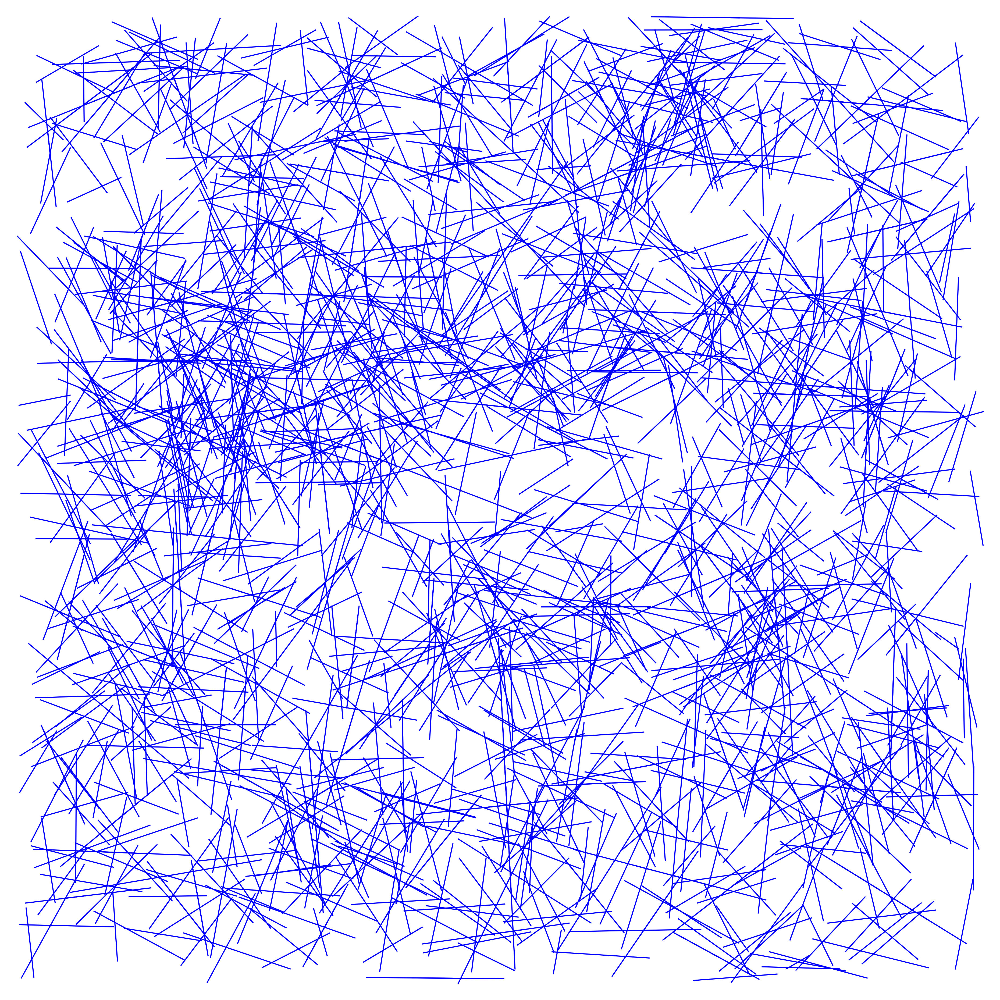

In [17]:
# 1. Define particle behavior parameters
params = {
    'p_run': 0.5,           # 50% chance of running
    'p_tumble': 0.5,        # 50% chance of tumbling
    'speed': 0.05,          # Distance per time step
    'p_link': 0.2,          # 20% chance of laying a link per step
    'L_link_mean': 0.1,     # Average link length
    'L_link_std': 0.02      # Std deviation of link length
}

# 2. Run the simulation
steps = 100
N = 100
dt = 1.0

simulate(N=N, steps=steps, dt=dt, particle_params=params)

# 3. Optional: Visualize the raw links and deposition points
plot_network(nodes, edges, step=steps)

In [18]:
from StructuralGT.networks import Network

Dynamics = Network('Dynamics')

In [19]:
from StructuralGT import Binarizer

B = Binarizer('Dynamics/dynamics_1.tif')

interactive(children=(Dropdown(description='Threshold', layout=Layout(display='flex', flex_flow='row', justify…

In [20]:
Dynamics.binarize()

Ran img_to_skel() in  0.3542797565460205 for skeleton with  221058 voxels


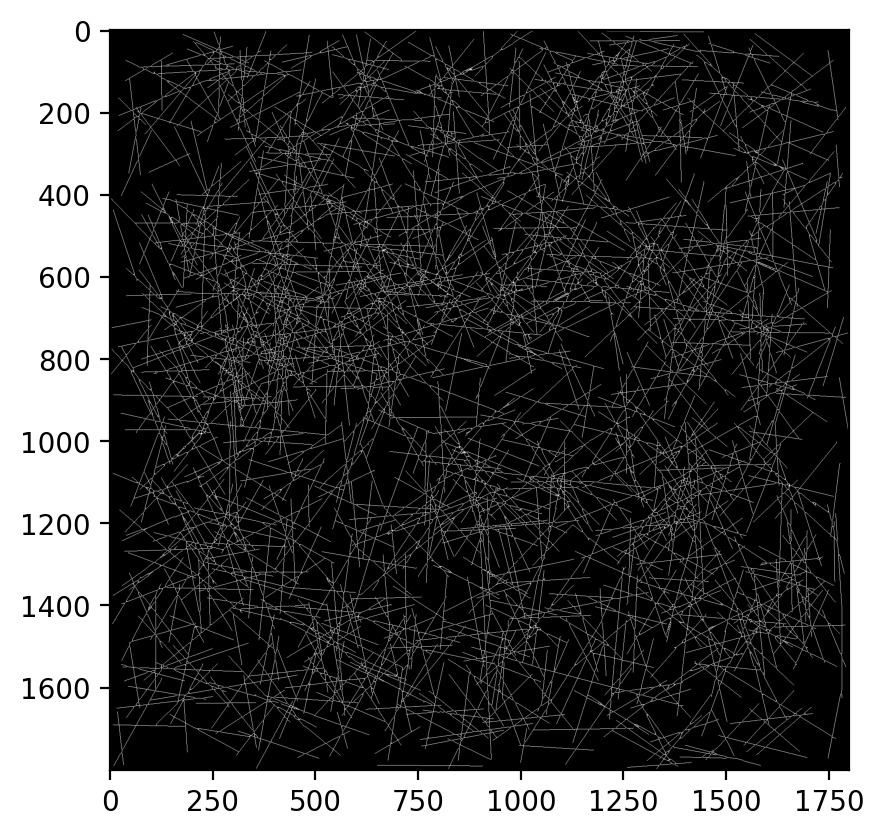

In [21]:
Dynamics.img_to_skel()
plt.imshow(Dynamics.skeleton, cmap='gray')

In [22]:
Dynamics.set_graph(sub=False)

implicit data copy when writing chunk: log/Edge_lens
implicit data copy when writing chunk: log/Node_lens


In [23]:
A = Dynamics.graph.get_adjacency()
print(A.shape)

(13482, 13482)


<Axes: >

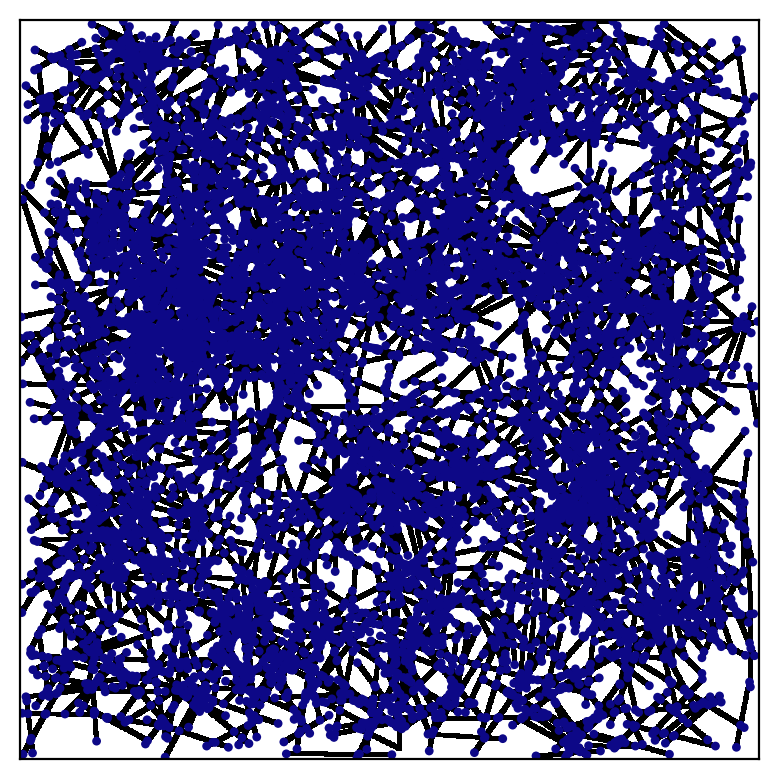

In [24]:
Dynamics.graph_plot()

In [25]:
from StructuralGT.structural import Size

S = Size()
S.compute(Dynamics)
print(f'Number of nodes is {S.number_of_nodes}')
print(f'Number of edges is {S.number_of_edges}')
print(f'Diameter is {S.diameter}')
print(f'Density (fraction of edges that exist compared to all possible edges in a complete graph) is {S.density}')

Number of nodes is 13482
Number of edges is 20379
Diameter is 157
Density (fraction of edges that exist compared to all possible edges in a complete graph) is 0.0002242520560097323


Average degree is 3.023141967067201


<Axes: >

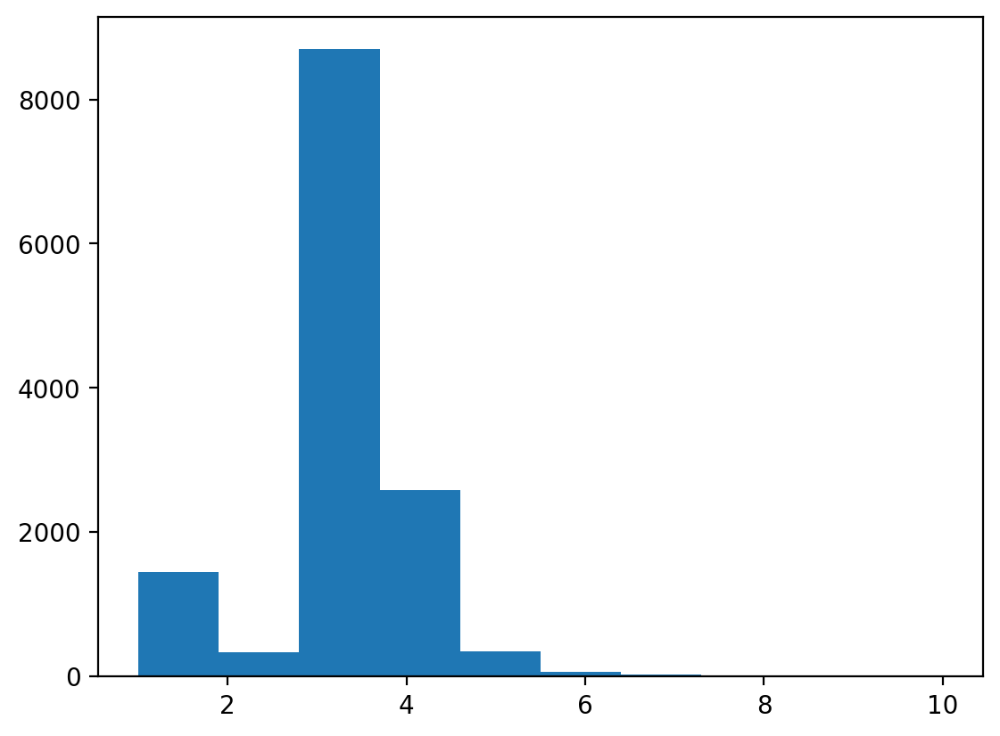

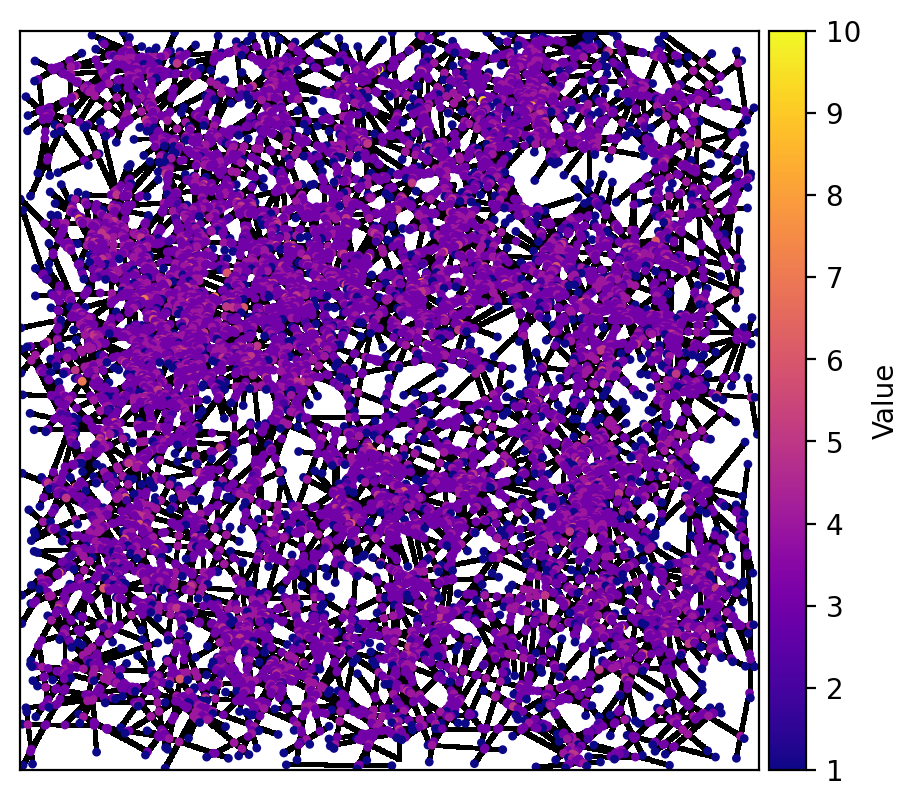

In [26]:
from StructuralGT.structural import Degree

D = Degree()
D.compute(Dynamics)
print(f'Average degree is {D.average_degree}')
plt.hist(D.degree)
Dynamics.node_plot(parameter=D.degree)

Average clustering coefficient is 0.11495568459297875


(array([8280., 1268.,  131., 3661.,    0.,    9.,  119.,    0.,    0.,
          14.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
 <BarContainer object of 10 artists>)

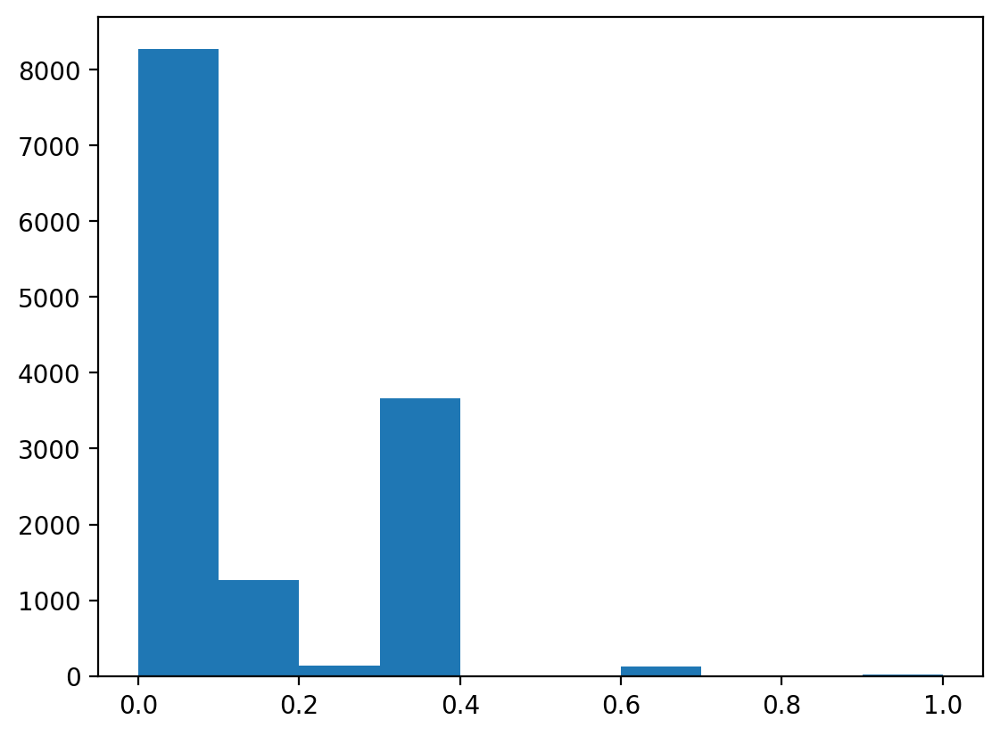

In [27]:
from StructuralGT.structural import Clustering

C = Clustering()
C.compute(Dynamics)

print(f'Average clustering coefficient is {C.average_clustering_coefficient}')

plt.hist(C.clustering)

In [28]:
from StructuralGT.structural import Assortativity

A = Assortativity()
A.compute(Dynamics)

print(f'Assortativity is {A.assortativity}')

Assortativity is 0.04088488465648884


## Are size parameters extensive properties of the network?

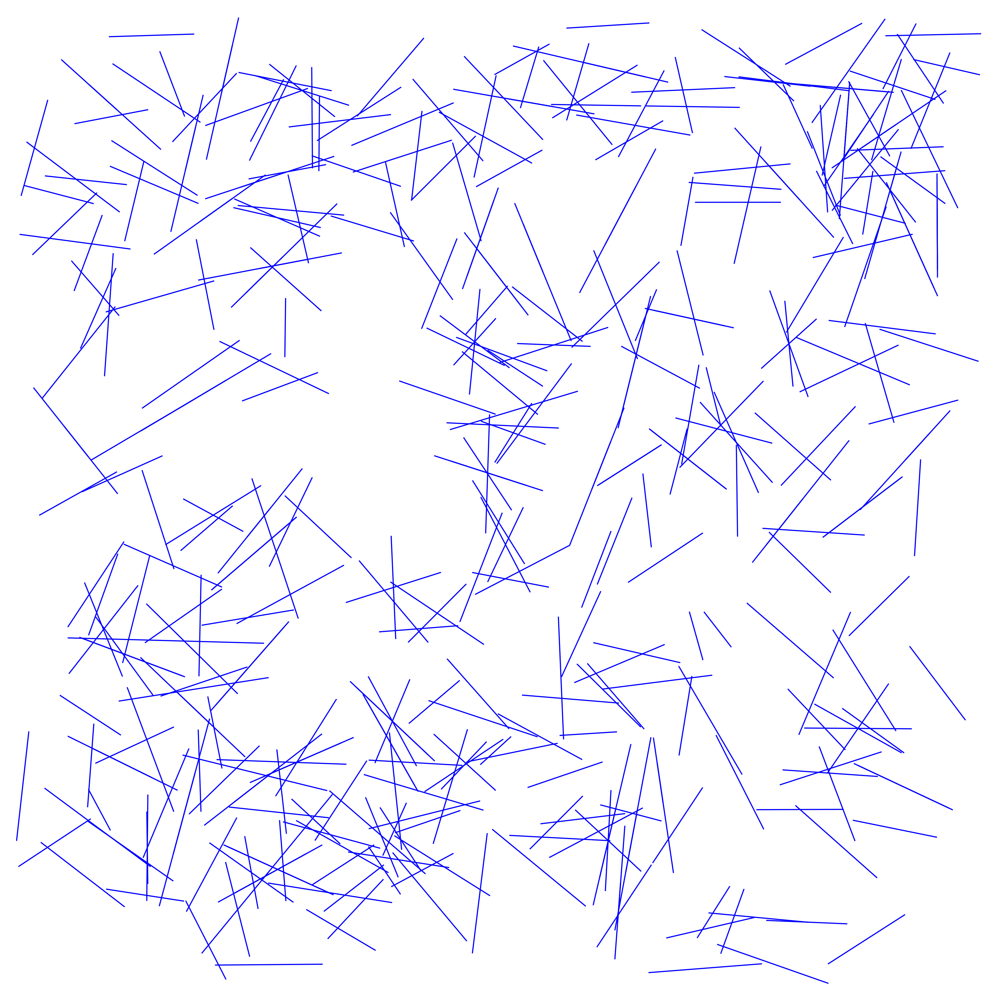

In [116]:
np.random.seed(42)

# 1. Define particle behavior parameters
params = {
    'p_run': 0.5,           # 50% chance of running
    'p_tumble': 0.5,        # 50% chance of tumbling
    'speed': 0.05,          # Distance per time step
    'p_link': 0.2,          # 20% chance of laying a link per step
    'L_link_mean': 0.1,     # Average link length
    'L_link_std': 0.02      # Std deviation of link length
}

# 2. Run the simulation
steps = 25
N = 100
dt = 1.0

simulate(N=N, steps=steps, dt=dt, particle_params=params)

# 3. Optional: Visualize the raw links and deposition points
plot_network(nodes, edges, fname='dynamics_seed42_t25.tif', step=steps)

In [101]:
from StructuralGT.networks import Network
from StructuralGT import Binarizer

Dynamics_seed42_t25 = Network('Dynamics_seed42_t25')
B = Binarizer('Dynamics_seed42_t25/dynamics_seed42_t25.tif')

interactive(children=(Dropdown(description='Threshold', layout=Layout(display='flex', flex_flow='row', justify…

Ran img_to_skel() in  0.14292001724243164 for skeleton with  56878 voxels


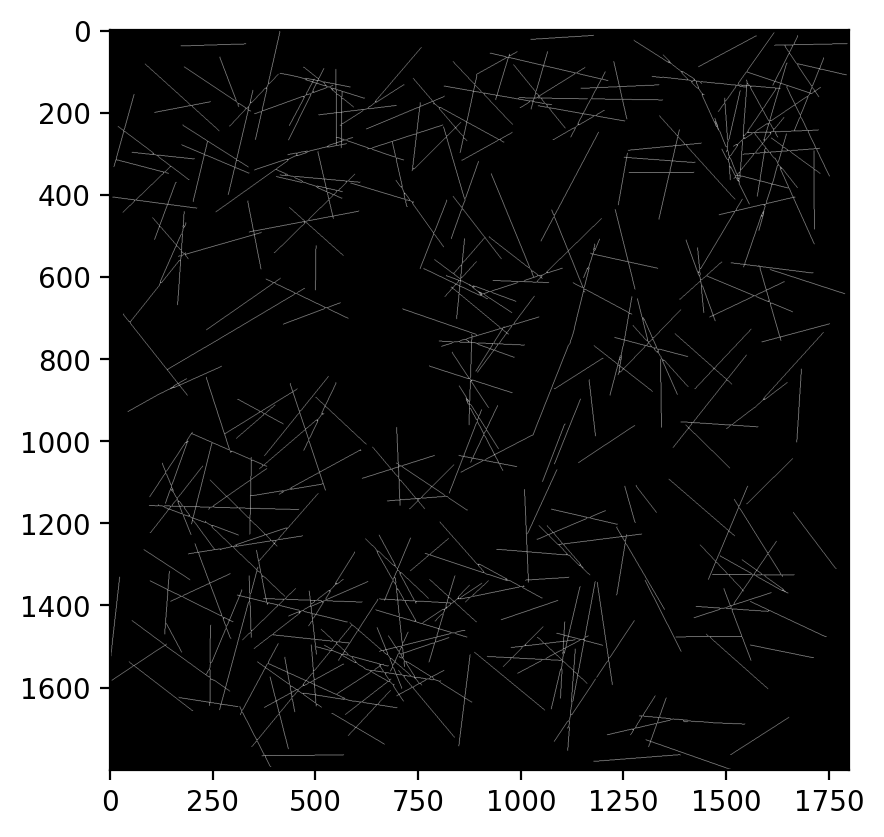

In [102]:
Dynamics_seed42_t25.binarize()
Dynamics_seed42_t25.img_to_skel()
plt.imshow(Dynamics_seed42_t25.skeleton, cmap='gray')

implicit data copy when writing chunk: log/Edge_lens
implicit data copy when writing chunk: log/Node_lens


<Axes: >

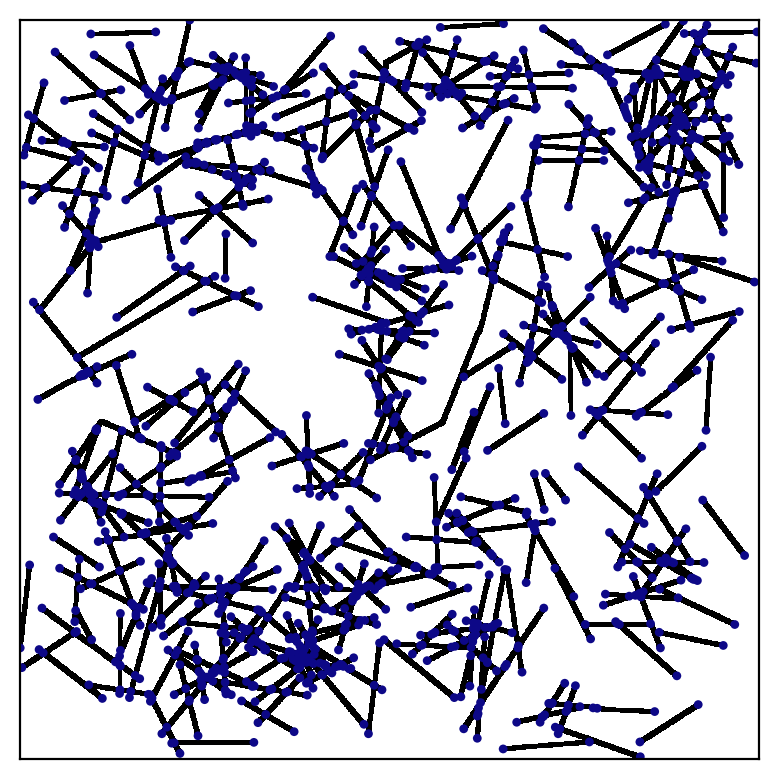

In [103]:
Dynamics_seed42_t25.set_graph(sub=False)
A = Dynamics_seed42_t25.graph.get_adjacency()
Dynamics_seed42_t25.graph_plot()

In [104]:
from StructuralGT.structural import Size

S25 = Size()
S25.compute(Dynamics_seed42_t25)
print(f'Number of nodes is {S25.number_of_nodes}')
print(f'Number of edges is {S25.number_of_edges}')
print(f'Diameter is {S25.diameter}')
print(f'Density (fraction of edges that exist compared to all possible edges in a complete graph) is {S25.density}')

s25 = S25.number_of_nodes
e25 = S25.number_of_edges
d25 = S25.diameter

Number of nodes is 1548
Number of edges is 1828
Diameter is 83
Density (fraction of edges that exist compared to all possible edges in a complete graph) is 0.001526669105328476


In [105]:
size = []
size.append(s25)

edges = []
edges.append(e25)

diameter = []
diameter.append(d25)

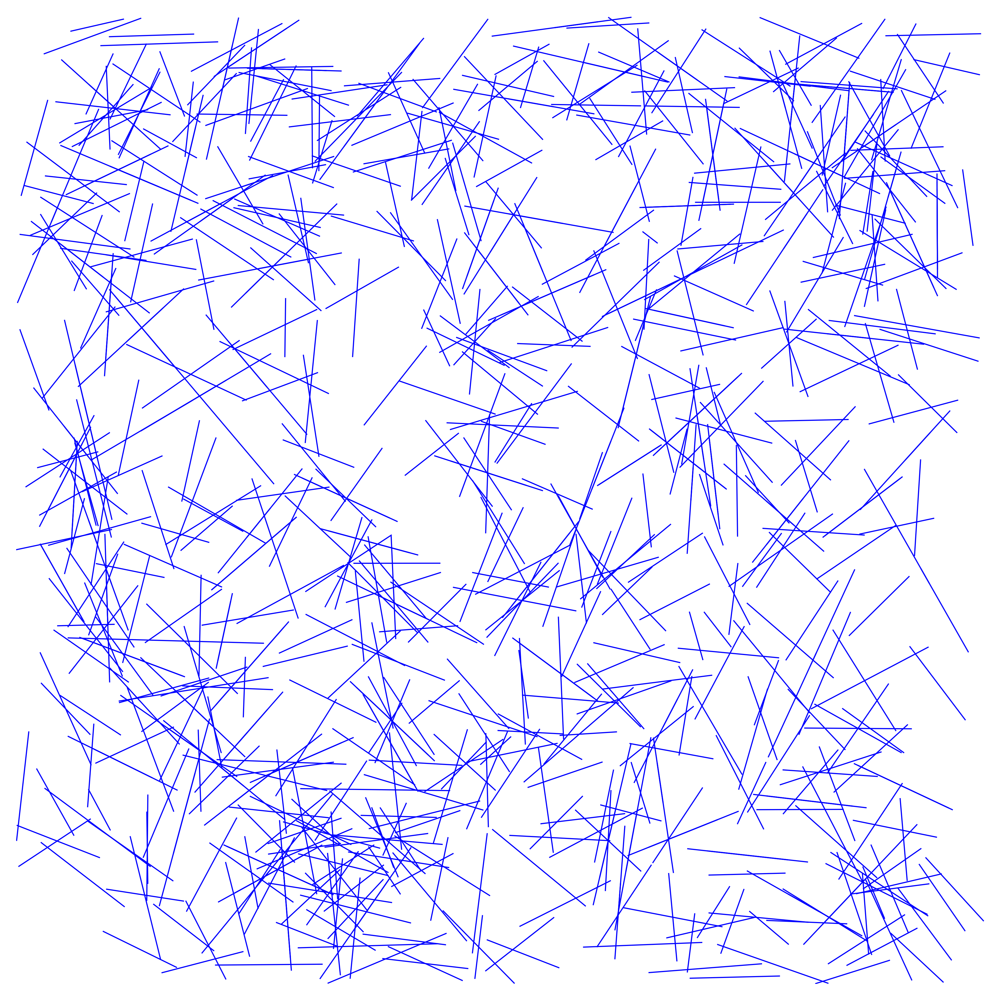

In [106]:
np.random.seed(42)

# 1. Define particle behavior parameters
params = {
    'p_run': 0.5,           # 50% chance of running
    'p_tumble': 0.5,        # 50% chance of tumbling
    'speed': 0.05,          # Distance per time step
    'p_link': 0.2,          # 20% chance of laying a link per step
    'L_link_mean': 0.1,     # Average link length
    'L_link_std': 0.02      # Std deviation of link length
}

# 2. Run the simulation
steps = 50
N = 100
dt = 1.0

simulate(N=N, steps=steps, dt=dt, particle_params=params)

# 3. Optional: Visualize the raw links and deposition points
plot_network(nodes, edges, fname='dynamics_seed42_t50.tif', step=steps)

In [107]:
from StructuralGT.networks import Network
from StructuralGT import Binarizer

Dynamics_seed42_t50 = Network('Dynamics_seed42_t50')
B = Binarizer('Dynamics_seed42_t50/Dynamics_seed42_t50.tif')

interactive(children=(Dropdown(description='Threshold', layout=Layout(display='flex', flex_flow='row', justify…

Ran img_to_skel() in  0.20854878425598145 for skeleton with  107716 voxels


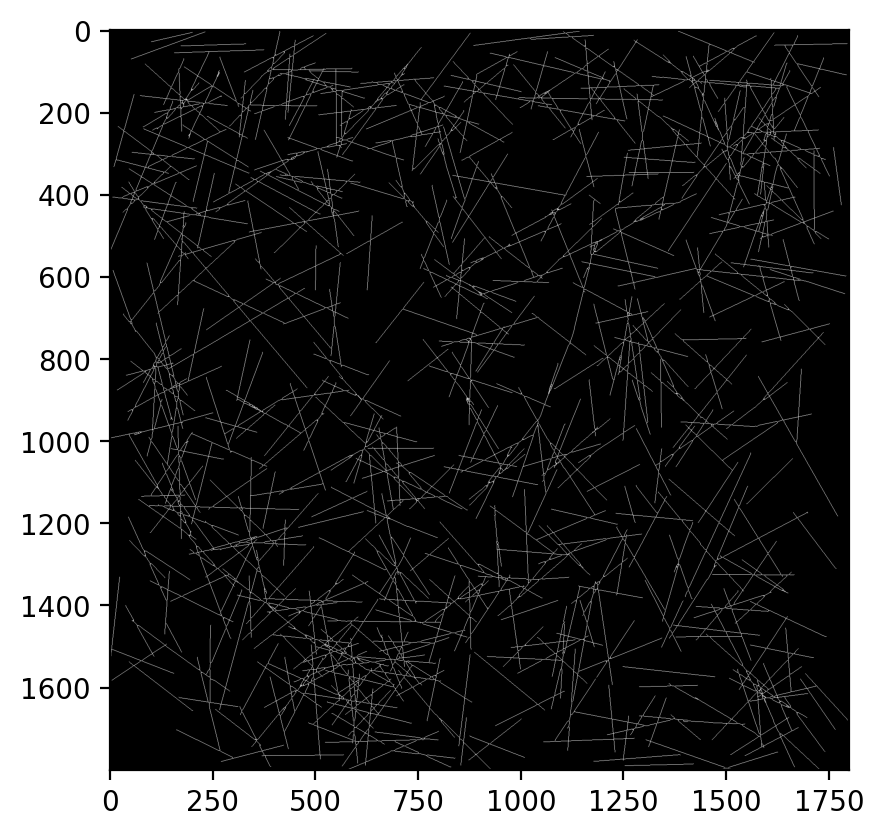

In [108]:
Dynamics_seed42_t50.binarize()
Dynamics_seed42_t50.img_to_skel()
plt.imshow(Dynamics_seed42_t50.skeleton, cmap='gray')

implicit data copy when writing chunk: log/Edge_lens
implicit data copy when writing chunk: log/Node_lens


<Axes: >

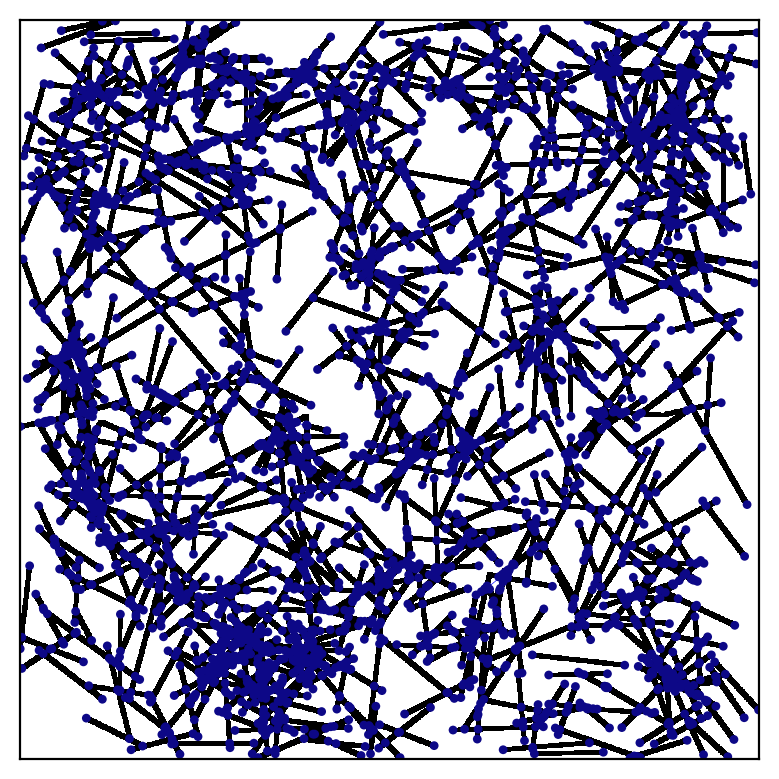

In [109]:
Dynamics_seed42_t50.set_graph(sub=False)
A = Dynamics_seed42_t50.graph.get_adjacency()
Dynamics_seed42_t50.graph_plot()

In [110]:
from StructuralGT.structural import Size

S50 = Size()
S50.compute(Dynamics_seed42_t50)
print(f'Number of nodes is {S50.number_of_nodes}')
print(f'Number of edges is {S50.number_of_edges}')
print(f'Diameter is {S50.diameter}')
print(f'Density (fraction of edges that exist compared to all possible edges in a complete graph) is {S50.density}')

s50 = S50.number_of_nodes
e50 = S50.number_of_edges
d50 = S50.diameter

Number of nodes is 4123
Number of edges is 5530
Diameter is 116
Density (fraction of edges that exist compared to all possible edges in a complete graph) is 0.0006507794113164773


In [111]:
size.append(s50)
edges.append(e50)
diameter.append(d50)

print(size)

[1548, 4123]


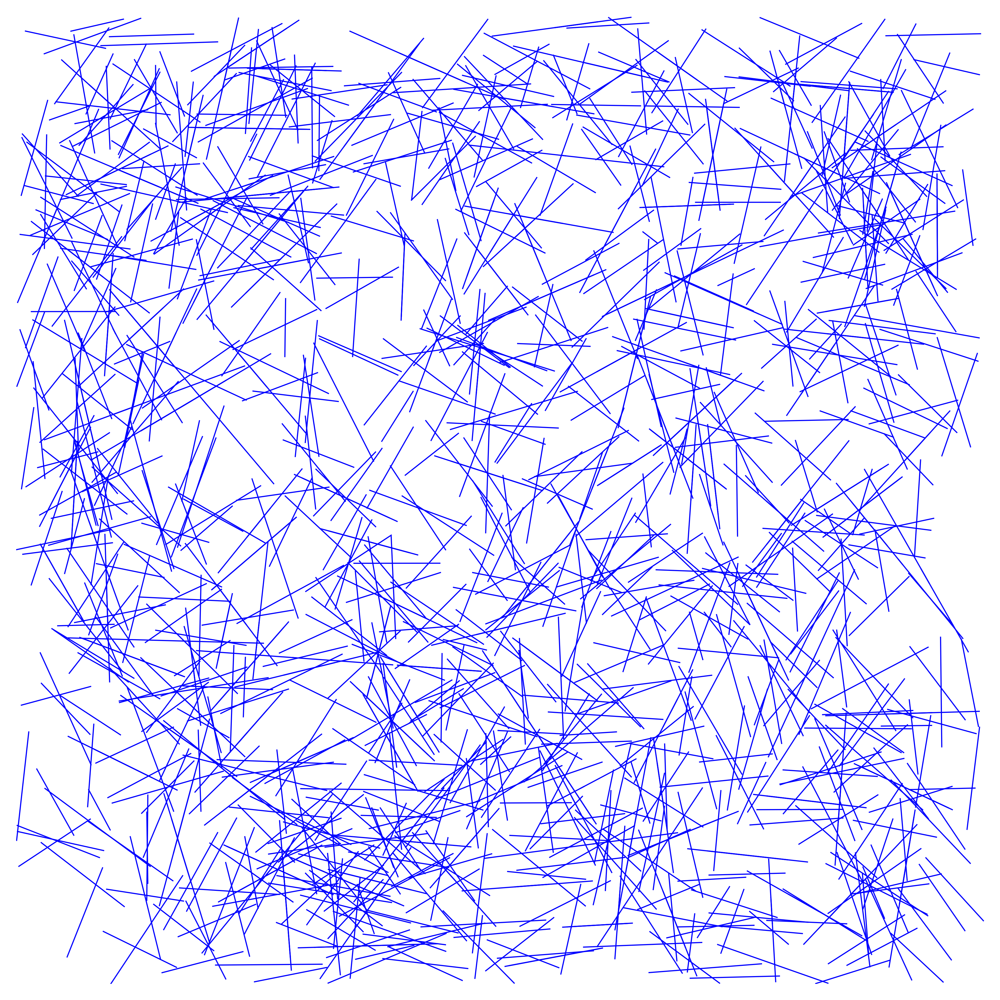

In [112]:
np.random.seed(42)

# 1. Define particle behavior parameters
params = {
    'p_run': 0.5,           # 50% chance of running
    'p_tumble': 0.5,        # 50% chance of tumbling
    'speed': 0.05,          # Distance per time step
    'p_link': 0.2,          # 20% chance of laying a link per step
    'L_link_mean': 0.1,     # Average link length
    'L_link_std': 0.02      # Std deviation of link length
}

# 2. Run the simulation
steps = 75
N = 100
dt = 1.0

simulate(N=N, steps=steps, dt=dt, particle_params=params)

# 3. Optional: Visualize the raw links and deposition points
plot_network(nodes, edges, fname='dynamics_seed42_t75.tif',step=steps)

In [113]:
from StructuralGT.networks import Network
from StructuralGT import Binarizer

Dynamics_seed42_t75 = Network('Dynamics_seed42_t75')
B = Binarizer('Dynamics_seed42_t75/Dynamics_seed42_t75.tif')

interactive(children=(Dropdown(description='Threshold', layout=Layout(display='flex', flex_flow='row', justify…

Ran img_to_skel() in  0.2460649013519287 for skeleton with  160979 voxels


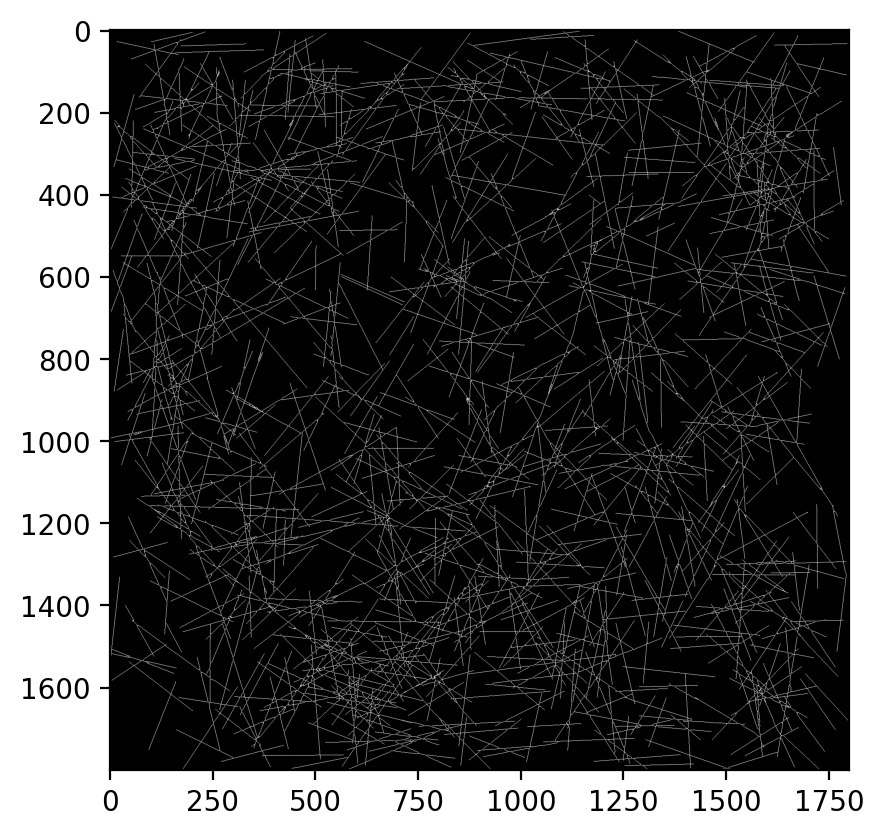

In [114]:
Dynamics_seed42_t75.binarize()
Dynamics_seed42_t75.img_to_skel()
plt.imshow(Dynamics_seed42_t75.skeleton, cmap='gray')

implicit data copy when writing chunk: log/Edge_lens
implicit data copy when writing chunk: log/Node_lens


<Axes: >

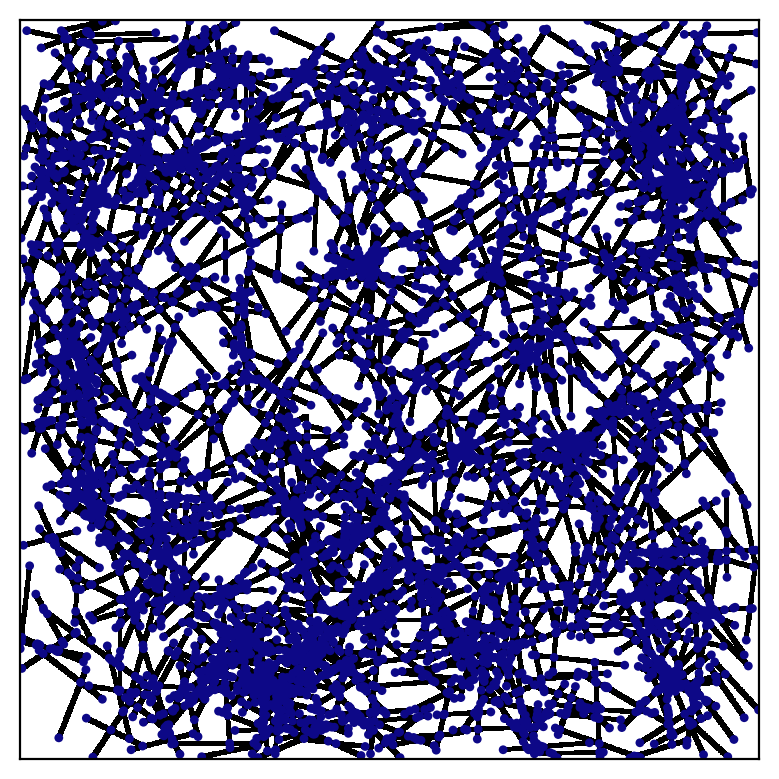

In [115]:
Dynamics_seed42_t75.set_graph(sub=False)
A = Dynamics_seed42_t75.graph.get_adjacency()
Dynamics_seed42_t75.graph_plot()

In [117]:
from StructuralGT.structural import Size

S75 = Size()
S75.compute(Dynamics_seed42_t75)
print(f'Number of nodes is {S75.number_of_nodes}')
print(f'Number of edges is {S75.number_of_edges}')
print(f'Diameter is {S75.diameter}')
print(f'Density (fraction of edges that exist compared to all possible edges in a complete graph) is {S50.density}')

s75 = S75.number_of_nodes
e75 = S75.number_of_edges
d75 = S75.diameter

size.append(s75)
edges.append(e75)
diameter.append(d75)

print(size)

Number of nodes is 7885
Number of edges is 11290
Diameter is 131
Density (fraction of edges that exist compared to all possible edges in a complete graph) is 0.0006507794113164773
[1548, 4123, 7885]


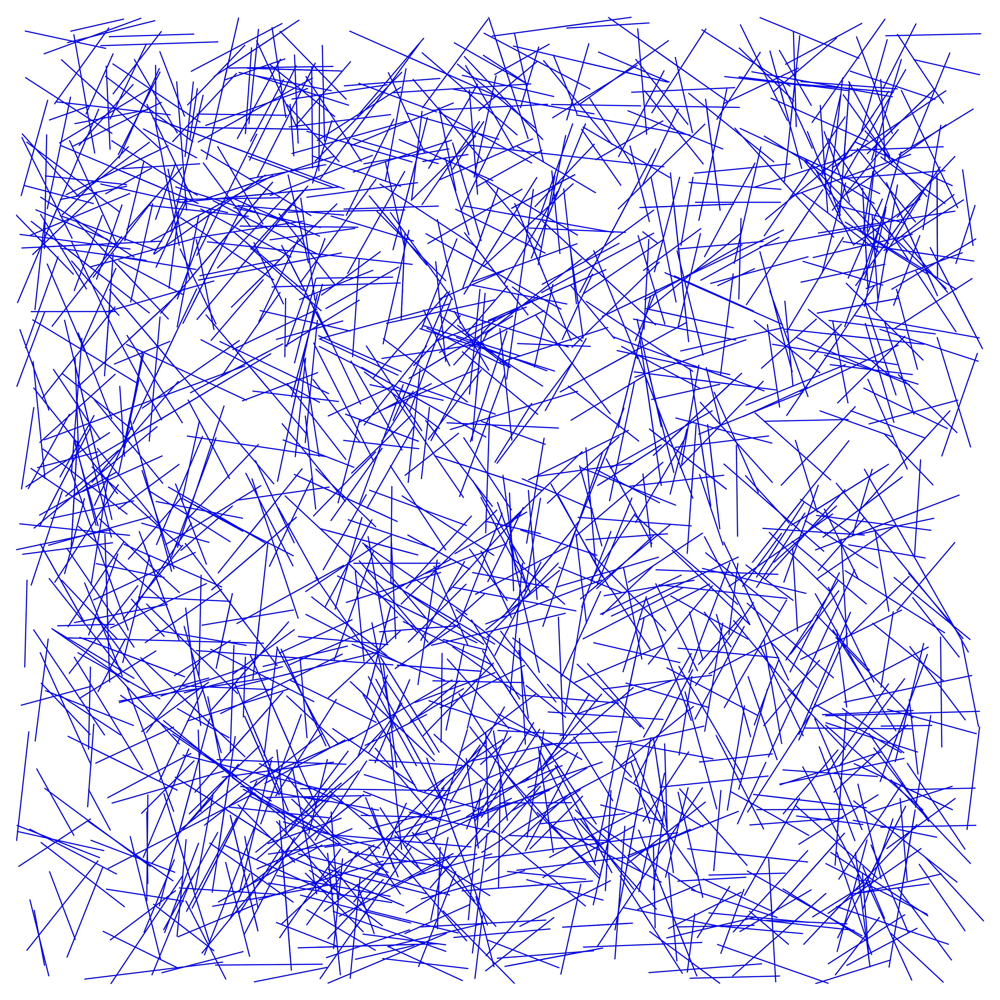

In [118]:
np.random.seed(42)

# 1. Define particle behavior parameters
params = {
    'p_run': 0.5,           # 50% chance of running
    'p_tumble': 0.5,        # 50% chance of tumbling
    'speed': 0.05,          # Distance per time step
    'p_link': 0.2,          # 20% chance of laying a link per step
    'L_link_mean': 0.1,     # Average link length
    'L_link_std': 0.02      # Std deviation of link length
}

# 2. Run the simulation
steps = 100
N = 100
dt = 1.0

simulate(N=N, steps=steps, dt=dt, particle_params=params)

# 3. Optional: Visualize the raw links and deposition points
plot_network(nodes, edges, fname='dynamics_seed42_t100.tif',step=steps)

In [119]:
from StructuralGT.networks import Network
from StructuralGT import Binarizer

Dynamics_seed42_t100 = Network('Dynamics_seed42_t100')
B = Binarizer('Dynamics_seed42_t100/Dynamics_seed42_t100.tif')

interactive(children=(Dropdown(description='Threshold', layout=Layout(display='flex', flex_flow='row', justify…

Ran img_to_skel() in  0.301785945892334 for skeleton with  209459 voxels


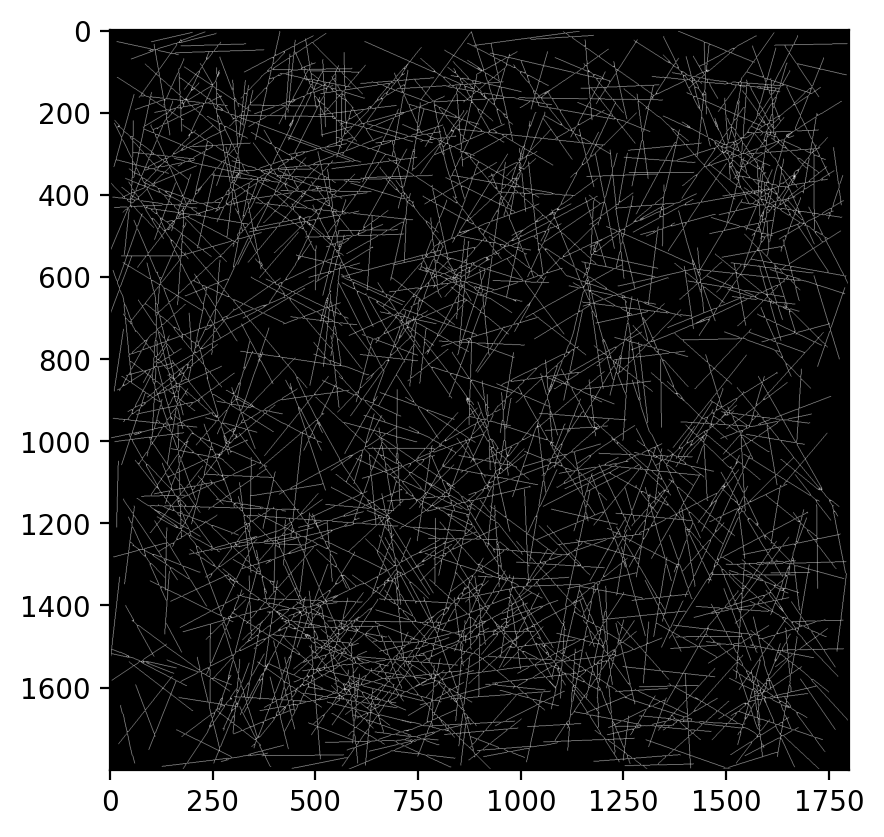

In [120]:
Dynamics_seed42_t100.binarize()
Dynamics_seed42_t100.img_to_skel()
plt.imshow(Dynamics_seed42_t100.skeleton, cmap='gray')

implicit data copy when writing chunk: log/Edge_lens
implicit data copy when writing chunk: log/Node_lens


<Axes: >

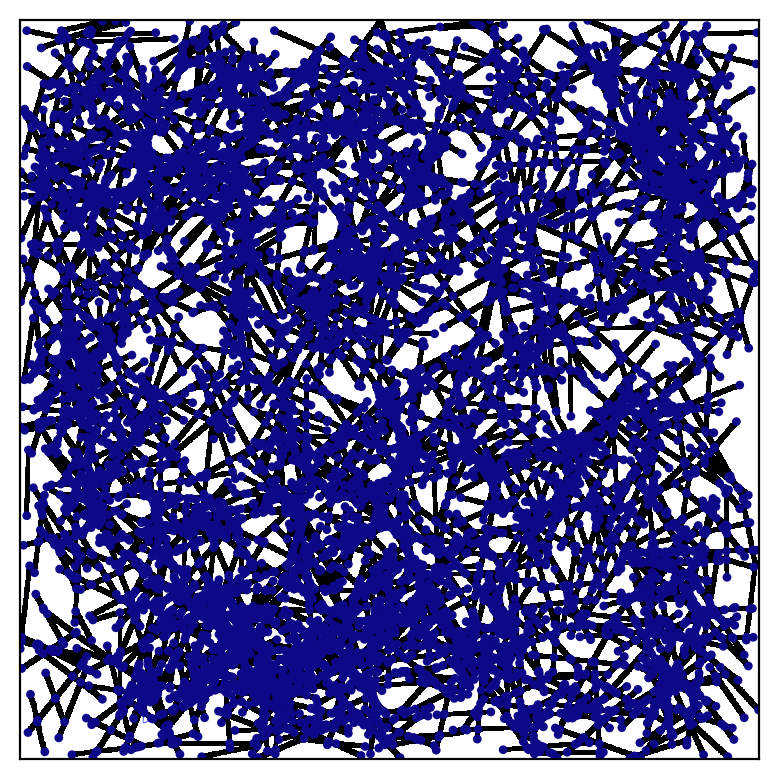

In [121]:
Dynamics_seed42_t100.set_graph(sub=False)
A = Dynamics_seed42_t100.graph.get_adjacency()
Dynamics_seed42_t100.graph_plot()

In [128]:
from StructuralGT.structural import Size

S100 = Size()
S100.compute(Dynamics_seed42_t100)
print(f'Number of nodes is {S100.number_of_nodes}')
print(f'Number of edges is {S100.number_of_edges}')
print(f'Diameter is {S100.diameter}')
print(f'Density (fraction of edges that exist compared to all possible edges in a complete graph) is {S50.density}')

s100 = S100.number_of_nodes
e100 = S100.number_of_edges
d100 = S100.diameter

size.append(s100)
edges.append(e100)
diameter.append(d100)

print(size)
#print(edges)

Number of nodes is 12176
Number of edges is 18143
Diameter is 150
Density (fraction of edges that exist compared to all possible edges in a complete graph) is 0.0006507794113164773
[1548, 4123, 7885, 12176, 12176, 12176, 12176]


[1548, 4123, 7885, 12176]


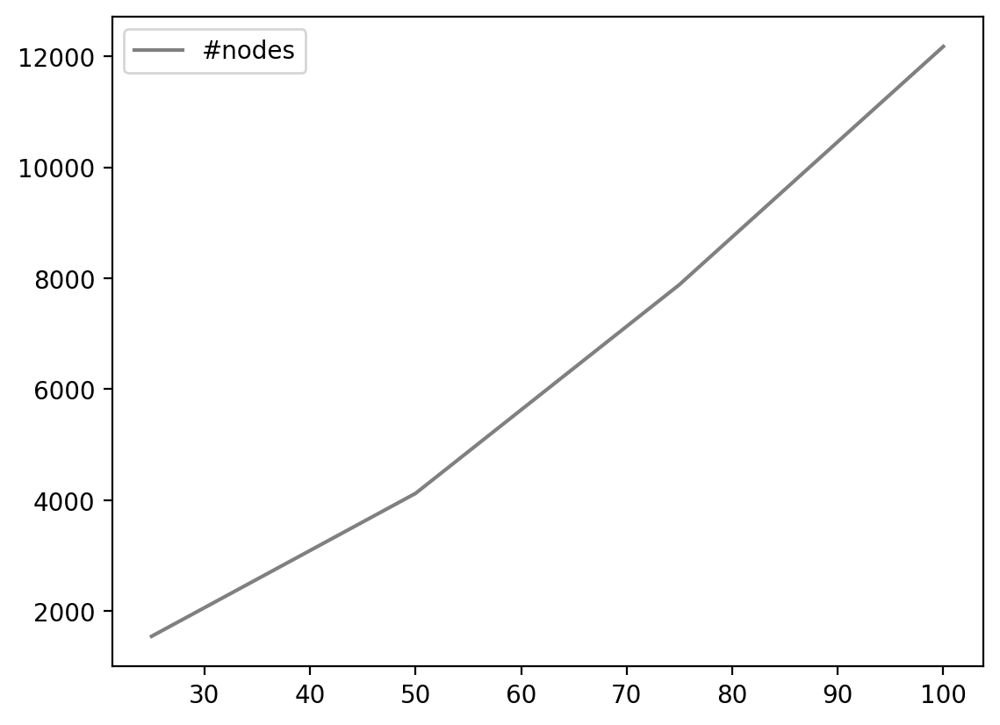

In [135]:
t = [25,50,75,100]
print(size[0:4])

plt.plot(t,size[0:4],label='#nodes',color='grey')
#plt.scatter(t,edges,label='#edges',color='blue')
#plt.scatter(t,diameter,label='diameter',color='cyan')
plt.legend()

Average degree is 2.3617571059431524
Average degree is 2.6825127334465195
Average degree is 2.8636651870640457
Average degree is 2.980124835742444
2.7220149655490404


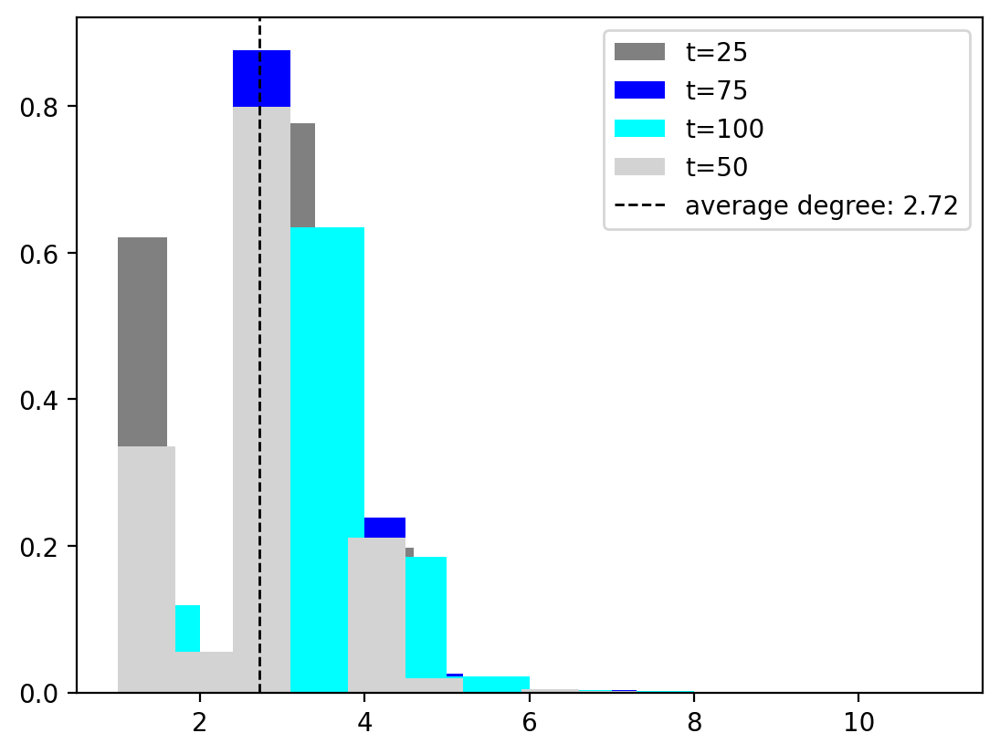

In [137]:
from StructuralGT.structural import Degree

D25 = Degree()
D25.compute(Dynamics_seed42_t25)
print(f'Average degree is {D25.average_degree}')
avd25 = D25.average_degree

D50 = Degree()
D50.compute(Dynamics_seed42_t50)
print(f'Average degree is {D50.average_degree}')
avd50 = D50.average_degree

D75 = Degree()
D75.compute(Dynamics_seed42_t75)
print(f'Average degree is {D75.average_degree}')
avd75 = D75.average_degree

D100 = Degree()
D100.compute(Dynamics_seed42_t100)
print(f'Average degree is {D100.average_degree}')
avd100 = D100.average_degree

av_d = [avd25, avd50, avd75, avd100]
mean_d = sum(av_d)/len(av_d)
print(mean_d)

plt.hist(D25.degree,label='t=25',color='grey',density=True)
plt.hist(D75.degree,label='t=75',color='blue',density=True)
plt.hist(D100.degree,label='t=100',color='cyan',density=True)
plt.hist(D50.degree,label='t=50',color='lightgrey',density=True)
plt.axvline(mean_d, color='k', linestyle='dashed', linewidth=1,label='average degree: 2.72')

plt.legend()